In [1]:
# core
import sys
import time

# custom
sys.path.append('../code/poloniex')
sys.path.append('../code')
import polo_eda as pe
import calc_TA_sigs as cts
import data_processing as dp

# installed
import pandas as pd
import numpy as np
import statsmodels.api as sm

# plotting
import plotly
plotly.offline.init_notebook_mode()
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Scatter, Figure, Layout, Candlestick
from plotly.tools import FigureFactory as FF
import plotly.graph_objs as go
import matplotlib.pyplot as plt
%matplotlib inline

/usr/local/lib/python3.5/dist-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [2]:
df = pe.read_trade_hist('BTC_POT')

In [3]:
# resamples to the hour
rs_full = dp.resample_ohlc(df, resamp='H')

In [4]:
rs_full = dp.make_mva_features(rs_full)

In [5]:
bars = cts.create_tas(bars=rs_full, verbose=True)

using multiplier of 1000000


In [6]:
indicators = ['bband_u_cl', # bollinger bands
             'bband_m_cl',
             'bband_l_cl',
             'bband_u_tp',
             'bband_m_tp',
             'bband_l_tp',
             'dema_cl',
             'dema_tp',
             'ema_cl',
             'ema_tp',
             'ht_tl_cl',
             'ht_tl_tp',
             'kama_cl',
             'kama_tp',
#              'mama_cl',
#              'mama_tp',
#              'fama_cl',
#              'fama_tp',
#              'mama_cl_osc',
#              'mama_tp_osc',
             'midp_cl',
             'midp_tp',
             'midpr',
             'sar',
             'tema_cl',
             'tema_tp',
             'trima_cl',
             'trima_tp',
             'wma_cl',
             'wma_tp',
             'adx',
             'adxr',
             'apo_cl',
             'apo_tp',
             'arup', # aroon
             'ardn',
             'aroonosc',
             'bop',
             'cci',
             'cmo_cl',
             'cmo_tp',
             'dx',
             'macd_cl',
             'macdsignal_cl',
             'macdhist_cl',
             'macd_tp',
             'macdsignal_tp',
             'macdhist_tp',
             'mfi',
             'mdi',
             'mdm',
             'mom_cl',
             'mom_tp',
             'pldi',
             'pldm',
             'ppo_tp',
             'roc_cl',
             'roc_tp',
             'rocp_cl',
             'rocp_tp',
             'rocr_cl',
             'rocr_tp',
             'rocr_cl_100',
             'rocr_tp_100',
             'rsi_cl',
             'rsi_tp',
             'slowk', # stochastic oscillator
             'slowd',
             'fastk',
             'fastd',
             'strsi_cl_k',
             'strsi_cl_d',
             'strsi_tp_k',
             'strsi_tp_d',
             'trix_cl',
             'trix_tp',
             'ultosc',
             'willr',
             'ad',
             'adosc',
             'obv_cl',
             'obv_tp',
             'atr',
             'natr',
             'trange',
             'ht_dcp_cl',
             'ht_dcp_tp',
             'ht_dcph_cl',
             'ht_dcph_tp',
             'ht_ph_cl',
             'ht_ph_tp',
             'ht_q_cl',
             'ht_q_tp',
             'ht_s_cl',
             'ht_s_tp',
             'ht_ls_cl',
             'ht_ls_tp',
             'ht_tr_cl',
             'ht_tr_tp'
             ]

In [100]:
# make target columns
col = '24h_price_diff'
bars[col] = bars['typical_price'].copy()
bars[col] = np.hstack((np.repeat(bars[col].iloc[24], 24), bars['typical_price'].iloc[24:].values - bars['typical_price'].iloc[:-24].values))
bars['24h_price_diff_pct'] = bars[col] / np.hstack((np.repeat(bars['typical_price'].iloc[24], 24), bars['typical_price'].iloc[24:].values))

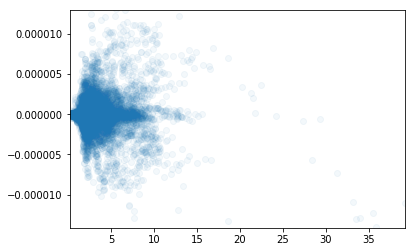

In [8]:
xcol = 'natr'
hist = 12
f = plt.scatter(bars[xcol].iloc[24-hist:-hist].values, bars['24h_price_diff'].iloc[24:].values, alpha=0.05)
ylim = plt.ylim([bars['24h_price_diff'].min()*0.3, bars['24h_price_diff'].max()*0.3])
xlim = plt.xlim([bars[xcol].min(), bars[xcol].max()])

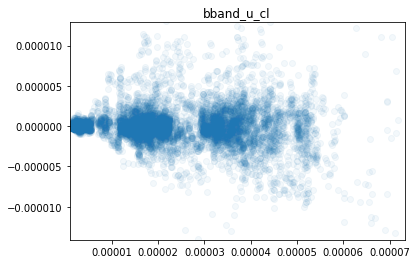

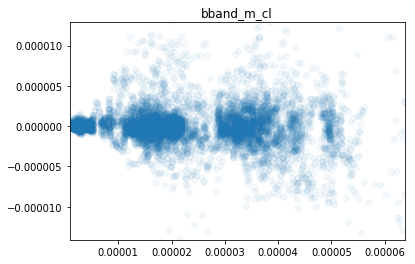

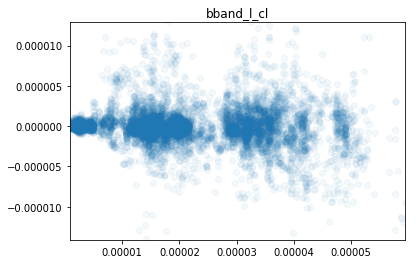

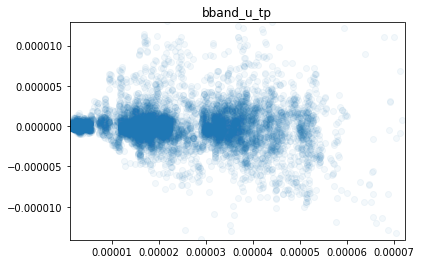

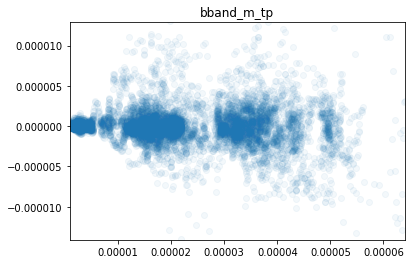

...

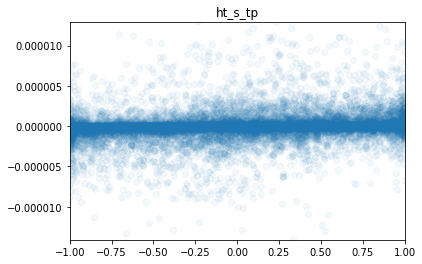

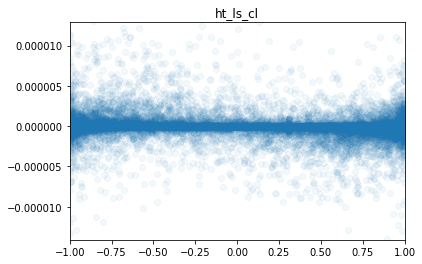

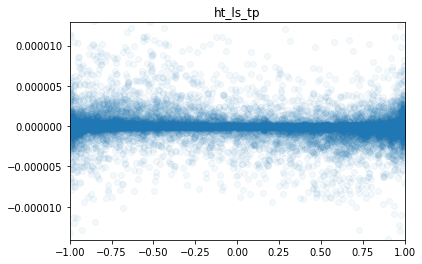

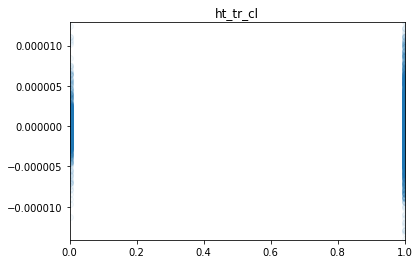

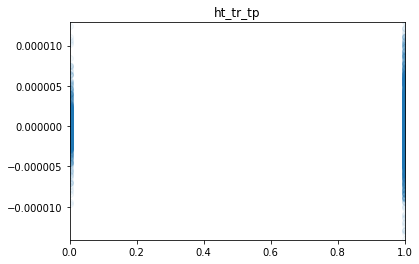

In [9]:
for i in indicators:
    xcol = i
    hist = 12
    f = plt.scatter(bars[xcol].iloc[24-hist:-hist].values, bars['24h_price_diff'].iloc[24:].values, alpha=0.05)
    ylim = plt.ylim([bars['24h_price_diff'].min()*0.3, bars['24h_price_diff'].max()*0.3])
    xlim = plt.xlim([bars[xcol].min(), bars[xcol].max()])
    plt.title(i)
    plt.show()

In [10]:
bars.columns

Index(['open', 'high', 'low', 'close', 'volume', 'direction_volume',
       'typical_price', 'mva_tp_24', 'mva_tp_24_diff', '24h_price_diff',
       ...
       'ht_ph_cl', 'ht_ph_tp', 'ht_q_cl', 'ht_q_tp', 'ht_s_cl', 'ht_s_tp',
       'ht_ls_cl', 'ht_ls_tp', 'ht_tr_cl', 'ht_tr_tp'],
      dtype='object', length=106)

In [11]:
latest_bars = bars.iloc[-1000:]

In [12]:
latest_bars['sar']

date
2017-08-31 06:00:00    0.000027
2017-08-31 07:00:00    0.000027
2017-08-31 08:00:00    0.000027
2017-08-31 09:00:00    0.000027
2017-08-31 10:00:00    0.000027
2017-08-31 11:00:00    0.000027
2017-08-31 12:00:00    0.000026
2017-08-31 13:00:00    0.000026
2017-08-31 14:00:00    0.000026
2017-08-31 15:00:00    0.000026
2017-08-31 16:00:00    0.000026
2017-08-31 17:00:00    0.000026
2017-08-31 18:00:00    0.000026
2017-08-31 19:00:00    0.000025
2017-08-31 20:00:00    0.000025
2017-08-31 21:00:00    0.000025
2017-08-31 22:00:00    0.000025
2017-08-31 23:00:00    0.000025
2017-09-01 00:00:00    0.000024
2017-09-01 01:00:00    0.000025
2017-09-01 02:00:00    0.000025
2017-09-01 03:00:00    0.000025
2017-09-01 04:00:00    0.000025
2017-09-01 05:00:00    0.000025
2017-09-01 06:00:00    0.000025
2017-09-01 07:00:00    0.000025
2017-09-01 08:00:00    0.000024
2017-09-01 09:00:00    0.000020
2017-09-01 10:00:00    0.000020
2017-09-01 11:00:00    0.000021
                         ...   
201

In [16]:
trace = Candlestick(latest_bars[['open', 'high', 'low', 'close']], x=latest_bars.index)
data = [trace, Scatter(x=latest_bars.index, y=latest_bars['sar'], mode='markers', name='parabolic SAR')]
iplot(data, filename='par_candles')

In [32]:
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit_regularized(method='elastic_net', alpha=1e-10, L1_wt=1.0)
fit.params

array([ -6.94475546e-07,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   1.20690467e-08,  -1.21873402e-09,
         0.00000000e+00,   0.00000000e+00,   8.60616296e-09,
         0.00000000e+00,  -8.17147065e-09,  -2.39704042e-09,
         1.09126424e-06,  -1.06590184e-06,  -5.01167041e-10,
         5.10288128e-10,   3.36321808e-10,   4.20350630e-08,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         7.89258495e-10,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   1.85233178e-08,
        -8.32062500e-07,   0.00000000e+00,   0.00000000e+00,
        -2.17364368e-08,

In [35]:
fit.params[1:]

array([  0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         1.20690467e-08,  -1.21873402e-09,   0.00000000e+00,
         0.00000000e+00,   8.60616296e-09,   0.00000000e+00,
        -8.17147065e-09,  -2.39704042e-09,   1.09126424e-06,
        -1.06590184e-06,  -5.01167041e-10,   5.10288128e-10,
         3.36321808e-10,   4.20350630e-08,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   7.89258495e-10,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   1.85233178e-08,  -8.32062500e-07,
         0.00000000e+00,   0.00000000e+00,  -2.17364368e-08,
         4.74077057e-07,

In [41]:
np.where(fit.params[1:] != 0)[0]

array([18, 19, 22, 24, 25, 26, 27, 28, 29, 30, 31, 35, 43, 44, 47, 48, 49,
       50, 51, 52, 53, 54, 55, 58, 59, 60, 68, 70, 73, 76, 77, 80, 83, 84,
       85, 86, 87, 89, 90, 91, 92, 94])

In [43]:
x_col_np = np.array(x_cols)

In [45]:
x_col_np[np.where(fit.params[1:] != 0)[0]]

array(['tema_cl', 'tema_tp', 'wma_cl', 'adx', 'adxr', 'apo_cl', 'apo_tp',
       'arup', 'ardn', 'aroonosc', 'bop', 'dx', 'mdi', 'mdm', 'pldi',
       'pldm', 'ppo_tp', 'roc_cl', 'roc_tp', 'rocp_cl', 'rocp_tp',
       'rocr_cl', 'rocr_tp', 'rsi_cl', 'rsi_tp', 'slowk', 'trix_cl',
       'ultosc', 'adosc', 'atr', 'natr', 'ht_dcp_tp', 'ht_ph_cl',
       'ht_ph_tp', 'ht_q_cl', 'ht_q_tp', 'ht_s_cl', 'ht_ls_cl', 'ht_ls_tp',
       'ht_tr_cl', 'ht_tr_tp', 'direction_volume'],
      dtype='<U16')

In [46]:
np.where(fit.params != 0)[0]

array([ 0, 19, 20, 23, 25, 26, 27, 28, 29, 30, 31, 32, 36, 44, 45, 48, 49,
       50, 51, 52, 53, 54, 55, 56, 59, 60, 61, 69, 71, 74, 77, 78, 81, 84,
       85, 86, 87, 88, 90, 91, 92, 93, 95])

In [67]:
hist = 12
x_cols = indicators + ['mva_tp_24_diff', 'direction_volume']
X = sm.add_constant(bars[x_cols].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.654
Model:                            OLS   Adj. R-squared:                  0.652
Method:                 Least Squares   F-statistic:                     410.1
Date:                Thu, 19 Oct 2017   Prob (F-statistic):               0.00
Time:                        10:57:17   Log-Likelihood:             2.1260e+05
No. Observations:               17665   AIC:                        -4.250e+05
Df Residuals:                   17583   BIC:                        -4.244e+05
Df Model:                          81                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.542e-06   1.06e-06      5.219      0.000    3.46e-06    7.62e-06
x1            -1.3400      0.323     -4.148      0.000      -1.973      -0.707
x2            -0.8620      0.321     -2.687      0.007      -1.491      -0.233
x3            -0.3804      0.329     -1.156      0.248      -1.026       0.265
x4             4.0913      0.336     12.169      0.000       3.432       4.750
x5             3.2464      0.334      9.708      0.000       2.591       3.902
x6             2.4019      0.343      7.004      0.000       1.730       3.074
x7           -15.2295      5.429     -2.805      0.005     -25.872      -4.587
x8            16.0109      5.430      2.949      0.003       5.368      26.654
x9           -31.2268     10.230     -3.052      0.002     -51.279     -11.174
x10           22.0516     10.235      2.154      0.031       1.989      42.114
x11            2.5891      0.122     21.158      0.000       2.349       2.829
x12           -2.4173      0.117    -20.681      0.000      -2.646      -2.188
x13            0.3896      0.080      4.879      0.000       0.233       0.546
x14           -0.7433      0.085     -8.787      0.000      -0.909      -0.577
x15            0.9007      0.107      8.398      0.000       0.690       1.111
x16           -1.5357      0.142    -10.852      0.000      -1.813      -1.258
x17            0.7886      0.073     10.781      0.000       0.645       0.932
x18            0.1077      0.013      8.347      0.000       0.082       0.133
x19         5.755e-05   8.34e-06      6.902      0.000    4.12e-05    7.39e-05
x20        -5.787e-05   8.21e-06     -7.047      0.000    -7.4e-05   -4.18e-05
x21        -5.253e-06   6.22e-06     -0.845      0.398   -1.74e-05    6.94e-06
x22         1.413e-05   6.36e-06      2.224      0.026    1.68e-06    2.66e-05
x23        -4.019e-06   1.41e-05     -0.284      0.776   -3.17e-05    2.37e-05
x24        -3.403e-06   1.43e-05     -0.238      0.812   -3.15e-05    2.46e-05
x25         -1.53e-08   2.94e-09     -5.208      0.000   -2.11e-08   -9.54e-09
x26         9.636e-09   2.68e-09      3.596      0.000    4.38e-09    1.49e-08
x27         6.527e-06   9.24e-07      7.067      0.000    4.72e-06    8.34e-06
x28        -4.208e-06   1.05e-06     -4.019      0.000   -6.26e-06   -2.16e-06
x29            0.0002   2.83e-05      5.487      0.000    9.99e-05       0.000
x30           -0.0002   2.83e-05     -5.487      0.000      -0.000   -9.99e-05
x31            0.0002   2.83e-05      5.487      0.000    9.99e-05       0.000
x32        -1.785e-09    2.5e-08     -0.071      0.943   -5.08e-08    4.72e-08
x33         3.558e-10   2.45e-10      1.454      0.146   -1.24e-10    8.35e-10
x34        -1.028e-05   1.96e-06     -5.252      0.000   -1.41e-05   -6.44e-06
x35         3.711e-05    6.6e-06      5.624      0.000    2.42e-05       5e-05
x3

In [51]:
np.where(fit.pvalues < 0.05)

(array([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 22, 25, 26, 27, 28, 29, 30, 31, 34, 35, 37, 38, 40, 41,
        42, 43, 44, 45, 48, 49, 50, 52, 54, 55, 56, 58, 59, 60, 61, 64, 69,
        73, 74, 75, 76, 77, 78, 79, 80, 81, 84, 87, 95]),)

In [54]:
# start at first pval because intercept is 0th index
sig_x_1 = x_col_np[np.where(fit.pvalues[1:] < 0.05)]

In [55]:
sig_x_1

array(['bband_u_cl', 'bband_m_cl', 'bband_u_tp', 'bband_m_tp',
       'bband_l_tp', 'dema_cl', 'dema_tp', 'ema_cl', 'ema_tp', 'ht_tl_cl',
       'ht_tl_tp', 'kama_cl', 'kama_tp', 'midp_cl', 'midp_tp', 'midpr',
       'sar', 'tema_cl', 'tema_tp', 'trima_tp', 'adx', 'adxr', 'apo_cl',
       'apo_tp', 'arup', 'ardn', 'aroonosc', 'cmo_cl', 'cmo_tp', 'macd_cl',
       'macdsignal_cl', 'macd_tp', 'macdsignal_tp', 'macdhist_tp', 'mfi',
       'mdi', 'mdm', 'pldi', 'pldm', 'ppo_tp', 'roc_tp', 'rocp_tp',
       'rocr_cl', 'rocr_tp', 'rocr_tp_100', 'rsi_cl', 'rsi_tp', 'slowk',
       'fastd', 'trix_cl', 'ad', 'adosc', 'obv_cl', 'obv_tp', 'atr',
       'natr', 'trange', 'ht_dcp_cl', 'ht_dcp_tp', 'ht_ph_cl', 'ht_q_tp',
       'direction_volume'],
      dtype='<U16')

In [56]:
hist = 12
X = sm.add_constant(bars[sig_x_1].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.653
Model:                            OLS   Adj. R-squared:                  0.652
Method:                 Least Squares   F-statistic:                     624.6
Date:                Thu, 19 Oct 2017   Prob (F-statistic):               0.00
Time:                        10:38:56   Log-Likelihood:             2.1257e+05
No. Observations:               17665   AIC:                        -4.250e+05
Df Residuals:                   17611   BIC:                        -4.246e+05
Df Model:                          53                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.517e-06   7.79e-07      7.080      0.000    3.99e-06    7.04e-06
x1            -0.9855      0.117     -8.437      0.000      -1.214      -0.757
x2             0.2879      0.832      0.346      0.729      -1.342       1.918
x3             3.2772      0.275     11.926      0.000       2.739       3.816
x4             2.4284      0.272      8.934      0.000       1.896       2.961
x5             1.5794      0.281      5.613      0.000       1.028       2.131
x6           -15.9293      4.985     -3.195      0.001     -25.700      -6.158
x7            16.3136      5.003      3.261      0.001       6.507      26.121
x8           -30.6991      4.987     -6.155      0.000     -40.475     -20.923
x9            17.7829      4.843      3.672      0.000       8.289      27.277
x10            2.5710      0.121     21.290      0.000       2.334       2.808
x11           -2.3847      0.115    -20.706      0.000      -2.610      -2.159
x12            0.3724      0.079      4.689      0.000       0.217       0.528
x13           -0.7212      0.084     -8.595      0.000      -0.886      -0.557
x14            0.9106      0.106      8.619      0.000       0.704       1.118
x15           -1.5707      0.138    -11.414      0.000      -1.840      -1.301
x16            0.7701      0.070     11.063      0.000       0.634       0.907
x17            0.1079      0.013      8.459      0.000       0.083       0.133
x18         4.635e-05    6.9e-06      6.717      0.000    3.28e-05    5.99e-05
x19        -4.676e-05    6.8e-06     -6.877      0.000   -6.01e-05   -3.34e-05
x20         6.281e-06   4.44e-07     14.148      0.000    5.41e-06    7.15e-06
x21        -1.718e-08   2.15e-09     -7.993      0.000   -2.14e-08    -1.3e-08
x22         1.125e-08   2.33e-09      4.833      0.000    6.69e-09    1.58e-08
x23         8.099e-06   6.46e-07     12.538      0.000    6.83e-06    9.36e-06
x24        -5.471e-06   6.96e-07     -7.860      0.000   -6.84e-06   -4.11e-06
x25         8.368e-05   1.19e-05      7.059      0.000    6.04e-05       0.000
x26        -8.368e-05   1.19e-05     -7.060      0.000      -0.000   -6.04e-05
x27         8.368e-05   1.19e-05      7.059      0.000    6.04e-05       0.000
x28        -4.972e-06   1.05e-06     -4.734      0.000   -7.03e-06   -2.91e-06
x29          2.87e-05   4.13e-06      6.942      0.000    2.06e-05    3.68e-05
x30          -42.5324      6.877     -6.184      0.000     -56.013     -29.052
x31          -52.9827      5.705     -9.286      0.000     -64.166     -41.799
x32           47.1296      6.115      7.707      0.000      35.144      59.115
x33           37.4089      5.636      6.637      0.000      26.362      48.456
x34            9.7206      1.422      6.834      0.000       6.933      12.509
x35        -1.387e-09   5.06e-10     -2.744      0.006   -2.38e-09   -3.96e-10
x3

In [57]:
# start at first pval because intercept is 0th index
sig_x_2 = sig_x_1[np.where(fit.pvalues[1:] < 0.05)]

In [58]:
hist = 12
X = sm.add_constant(bars[sig_x_2].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.653
Model:                            OLS   Adj. R-squared:                  0.652
Method:                 Least Squares   F-statistic:                     636.7
Date:                Thu, 19 Oct 2017   Prob (F-statistic):               0.00
Time:                        10:39:59   Log-Likelihood:             2.1257e+05
No. Observations:               17665   AIC:                        -4.250e+05
Df Residuals:                   17612   BIC:                        -4.246e+05
Df Model:                          52                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.542e-06   2.31e-07      6.671      0.000    1.09e-06    1.99e-06
x1            -0.9774      0.114     -8.539      0.000      -1.202      -0.753
x2             3.3615      0.128     26.228      0.000       3.110       3.613
x3             2.5163      0.095     26.378      0.000       2.329       2.703
x4             1.6716      0.092     18.200      0.000       1.492       1.852
x5           -15.9443      4.985     -3.199      0.001     -25.715      -6.174
x6            16.3250      5.003      3.263      0.001       6.518      26.131
x7           -29.9586      4.505     -6.650      0.000     -38.790     -21.128
x8            17.1045      4.429      3.862      0.000       8.423      25.786
x9             2.5729      0.121     21.330      0.000       2.336       2.809
x10           -2.3862      0.115    -20.736      0.000      -2.612      -2.161
x11            0.3722      0.079      4.687      0.000       0.217       0.528
x12           -0.7212      0.084     -8.594      0.000      -0.886      -0.557
x13            0.9076      0.105      8.620      0.000       0.701       1.114
x14           -1.5698      0.138    -11.410      0.000      -1.839      -1.300
x15            0.7709      0.070     11.082      0.000       0.635       0.907
x16            0.1078      0.013      8.456      0.000       0.083       0.133
x17         4.591e-05   6.78e-06      6.771      0.000    3.26e-05    5.92e-05
x18        -4.632e-05   6.68e-06     -6.933      0.000   -5.94e-05   -3.32e-05
x19         6.247e-06   4.33e-07     14.427      0.000     5.4e-06     7.1e-06
x20        -1.718e-08   2.15e-09     -7.993      0.000   -2.14e-08    -1.3e-08
x21         1.125e-08   2.33e-09      4.833      0.000    6.69e-09    1.58e-08
x22         8.128e-06    6.4e-07     12.693      0.000    6.87e-06    9.38e-06
x23        -5.526e-06   6.78e-07     -8.157      0.000   -6.85e-06    -4.2e-06
x24         8.154e-05   1.13e-05      7.196      0.000    5.93e-05       0.000
x25        -8.154e-05   1.13e-05     -7.197      0.000      -0.000   -5.93e-05
x26         8.154e-05   1.13e-05      7.196      0.000    5.93e-05       0.000
x27        -2.551e-05   4.16e-06     -6.130      0.000   -3.37e-05   -1.74e-05
x28         2.944e-05   3.89e-06      7.573      0.000    2.18e-05    3.71e-05
x29          -41.9857      6.693     -6.273      0.000     -55.105     -28.866
x30          -52.0708      5.061    -10.289      0.000     -61.991     -42.151
x31           46.4772      5.817      7.990      0.000      35.075      57.880
x32           36.6752      5.222      7.023      0.000      26.439      46.911
x33            9.8020      1.403      6.987      0.000       7.052      12.552
x34        -1.392e-09   5.05e-10     -2.753      0.006   -2.38e-09   -4.01e-10
x35         9.681e-09   1.48e-09      6.536      0.000    6.78e-09    1.26e-08
x3

In [61]:
# start at first pval because intercept is 0th index
sig_x_3 = sig_x_2[np.where(fit.pvalues[1:] < 0.05)]

In [62]:
hist = 12
X = sm.add_constant(bars[sig_x_3].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.653
Model:                            OLS   Adj. R-squared:                  0.652
Method:                 Least Squares   F-statistic:                     636.7
Date:                Thu, 19 Oct 2017   Prob (F-statistic):               0.00
Time:                        10:41:40   Log-Likelihood:             2.1257e+05
No. Observations:               17665   AIC:                        -4.250e+05
Df Residuals:                   17612   BIC:                        -4.246e+05
Df Model:                          52                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       3.118e-06   4.44e-07      7.024      0.000    2.25e-06    3.99e-06
x1            -0.9774      0.114     -8.539      0.000      -1.202      -0.753
x2             3.3614      0.128     26.227      0.000       3.110       3.613
x3             2.5164      0.095     26.380      0.000       2.329       2.703
x4             1.6716      0.092     18.200      0.000       1.492       1.852
x5           -15.9443      4.985     -3.199      0.001     -25.715      -6.174
x6            16.3249      5.003      3.263      0.001       6.518      26.131
x7           -29.9586      4.505     -6.650      0.000     -38.790     -21.128
x8            17.1045      4.429      3.862      0.000       8.423      25.786
x9             2.5729      0.121     21.330      0.000       2.336       2.809
x10           -2.3862      0.115    -20.736      0.000      -2.612      -2.161
x11            0.3722      0.079      4.687      0.000       0.217       0.528
x12           -0.7212      0.084     -8.594      0.000      -0.886      -0.557
x13            0.9076      0.105      8.620      0.000       0.701       1.114
x14           -1.5698      0.138    -11.410      0.000      -1.839      -1.300
x15            0.7709      0.070     11.082      0.000       0.635       0.907
x16            0.1078      0.013      8.456      0.000       0.083       0.133
x17         4.591e-05   6.78e-06      6.771      0.000    3.26e-05    5.92e-05
x18        -4.632e-05   6.68e-06     -6.933      0.000   -5.94e-05   -3.32e-05
x19         6.247e-06   4.33e-07     14.427      0.000     5.4e-06     7.1e-06
x20        -1.718e-08   2.15e-09     -7.993      0.000   -2.14e-08    -1.3e-08
x21         1.125e-08   2.33e-09      4.833      0.000    6.69e-09    1.58e-08
x22         8.128e-06    6.4e-07     12.693      0.000    6.87e-06    9.38e-06
x23        -5.526e-06   6.78e-07     -8.157      0.000   -6.85e-06    -4.2e-06
x24         6.685e-05   9.15e-06      7.306      0.000    4.89e-05    8.48e-05
x25        -6.685e-05   9.15e-06     -7.306      0.000   -8.48e-05   -4.89e-05
x26         6.685e-05   9.15e-06      7.306      0.000    4.89e-05    8.48e-05
x27        -1.198e-05   1.64e-06     -7.302      0.000   -1.52e-05   -8.76e-06
x28         1.204e-05   1.64e-06      7.321      0.000    8.81e-06    1.53e-05
x29          -41.9857      6.693     -6.273      0.000     -55.105     -28.866
x30          -52.0708      5.061    -10.289      0.000     -61.991     -42.151
x31           46.4772      5.817      7.990      0.000      35.075      57.880
x32           36.6752      5.222      7.023      0.000      26.439      46.911
x33            9.8020      1.403      6.987      0.000       7.052      12.552
x34        -1.392e-09   5.05e-10     -2.753      0.006   -2.38e-09   -4.01e-10
x35         9.681e-09   1.48e-09      6.536      0.000    6.78e-09    1.26e-08
x3

In [101]:
hist = 12
not_converged = True
cur_x_cols = np.array(x_cols)
iterations = 0
while not_converged:
    iterations += 1
    print(iterations)
    X = sm.add_constant(bars[cur_x_cols].iloc[24 - hist:-hist].values)
    y = bars['24h_price_diff_pct'].iloc[24:].values
    model = sm.OLS(y[:-1000], X[:-1000])
    fit = model.fit()
    if len(np.where(fit.pvalues[1:] > 0.05)[0]) != 0:
        print('dropping columns:', cur_x_cols[np.where(fit.pvalues[1:] > 0.05)[0]])
        print('with p-values:', fit.pvalues[1:][np.where(fit.pvalues[1:] > 0.05)[0]])
        cur_x_cols = cur_x_cols[np.where(fit.pvalues[1:] < 0.05)[0]]
    else:
        not_converged = False

1
dropping columns: ['tema_cl' 'tema_tp' 'trima_cl' 'trima_tp' 'wma_cl' 'wma_tp' 'adxr' 'dx'
 'macdhist_cl' 'mfi' 'mom_cl' 'mom_tp' 'pldi' 'roc_tp' 'rocp_tp'
 'rocr_tp_100' 'slowk' 'slowd' 'fastk' 'fastd' 'strsi_cl_k' 'strsi_cl_d'
 'strsi_tp_k' 'strsi_tp_d' 'ultosc' 'obv_tp' 'natr' 'ht_dcp_cl'
 'ht_dcph_cl' 'ht_dcph_tp' 'ht_ph_cl' 'ht_ph_tp' 'ht_s_cl' 'ht_s_tp'
 'ht_ls_cl' 'ht_ls_tp' 'ht_tr_cl' 'ht_tr_tp' 'mva_tp_24_diff']
with p-values: [ 0.35254173  0.27242669  0.24493531  0.66904412  0.4396927   0.61240431
  0.43067533  0.30785185  0.80092718  0.29100937  0.35030369  0.07382179
  0.88026448  0.10967464  0.85966941  0.10410871  0.18545997  0.21678737
  0.92883597  0.1854619   0.25244695  0.43095633  0.23626504  0.93537654
  0.61469984  0.43276593  0.8564903   0.14892752  0.18002724  0.55926083
  0.39240767  0.68012039  0.07339329  0.36820395  0.60501819  0.68927076
  0.64343968  0.96206818  0.24744185]
2
dropping columns: ['macdhist_tp']
with p-values: [ 0.6107329]
3


In [102]:
past_preds = fit.predict(X[:-1000])

In [105]:
data = [Scatter(x=past_preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [115]:
conf = fit.conf_int(0.05)  # 95% confidence intervals

In [118]:
preds = np.dot(X[:-1000], conf[:, 0])
data = [Scatter(x=preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual, lower 99% conf interval',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [119]:
preds = np.dot(X[:-1000], conf[:, 1])
data = [Scatter(x=preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual, upper 95% conf interval',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [120]:
model = sm.OLS(y[:-1000], X[:-1000])
fit_reg = model.fit_regularized(method='elastic_net', alpha=1e-10, L1_wt=1.0)
fit_reg.params

array([ -5.11665102e-03,   9.06744409e+02,   3.37584604e+01,
         3.92629508e+01,   0.00000000e+00,   0.00000000e+00,
        -6.36125883e+01,  -6.88427127e+01,   0.00000000e+00,
        -4.68862013e+01,   0.00000000e+00,  -8.00713564e+01,
        -9.66438694e+01,  -5.48376752e+02,   0.00000000e+00,
         4.11596630e+02,  -9.92636019e+01,  -2.52645873e+01,
         1.75763882e+02,  -2.26206293e-04,   7.25319159e-02,
        -3.10691008e-02,  -1.20239785e-04,   4.03822856e-05,
         2.64945903e-05,  -1.15644855e-03,   3.85470516e-05,
        -1.77525605e-04,   2.51021496e-04,   0.00000000e+00,
        -5.60753710e+04,   2.71508930e+04,  -3.99880334e+04,
         1.71331618e-04,  -1.45148594e-02,   6.17885653e-04,
         5.41271678e-03,   5.09743411e-03,   0.00000000e+00,
         1.34296622e-02,   4.71884008e-03,  -4.71678401e-05,
        -1.42500279e-04,   1.47747931e-05,   1.58480656e-03,
         5.10847345e-04,  -4.36518739e-05,   3.81767322e-06,
        -4.20112701e-04,

In [126]:
preds = fit_reg.predict(X[:-1000])
data = [Scatter(x=preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [129]:
X_fit = sm.add_constant(preds)
y_fit = y[:-1000]
model = sm.OLS(y_fit, X_fit)
fit_fit = model.fit()
fit_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.510
Model:                            OLS   Adj. R-squared:                  0.510
Method:                 Least Squares   F-statistic:                 1.839e+04
Date:                Thu, 19 Oct 2017   Prob (F-statistic):               0.00
Time:                        11:44:05   Log-Likelihood:                 21024.
No. Observations:               17665   AIC:                        -4.204e+04
Df Residuals:                   17663   BIC:                        -4.203e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -1.999e-05      0.001     -0.036      0.971      -0.001       0.001
x1             1.0067      0.007    135.600      0.000       0.992       1.021
==============================================================================
Omnibus:                     5429.456   Durbin-Watson:                   0.295
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           459229.137
Skew:                          -0.532   Prob(JB):                         0.00
Kurtosis:                      27.956   Cond. No.                         13.4
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [132]:
fit_fit.params

array([ -1.99892233e-05,   1.00667680e+00])

In [150]:
x_line = np.linspace(min(preds), max(preds), 100)
y_line = fit_fit.params[1]*x_line + fit_fit.params[0]

In [151]:
x_line

array([-1.28748339, -1.26456541, -1.24164742, -1.21872943, -1.19581144,
       -1.17289345, -1.14997546, -1.12705747, -1.10413949, -1.0812215 ,
       -1.05830351, -1.03538552, -1.01246753, -0.98954954, -0.96663156,
       -0.94371357, -0.92079558, -0.89787759, -0.8749596 , -0.85204161,
       -0.82912362, -0.80620564, -0.78328765, -0.76036966, -0.73745167,
       -0.71453368, -0.69161569, -0.66869771, -0.64577972, -0.62286173,
       -0.59994374, -0.57702575, -0.55410776, -0.53118978, -0.50827179,
       -0.4853538 , -0.46243581, -0.43951782, -0.41659983, -0.39368184,
       -0.37076386, -0.34784587, -0.32492788, -0.30200989, -0.2790919 ,
       -0.25617391, -0.23325593, -0.21033794, -0.18741995, -0.16450196,
       -0.14158397, -0.11866598, -0.09574799, -0.07283001, -0.04991202,
       -0.02699403, -0.00407604,  0.01884195,  0.04175994,  0.06467792,
        0.08759591,  0.1105139 ,  0.13343189,  0.15634988,  0.17926787,
        0.20218586,  0.22510384,  0.24802183,  0.27093982,  0.29

In [160]:
conf = fit_fit.conf_int(0.05)

In [155]:
preds_fit = fit_fit.predict(X_fit)
preds_min = conf[0, 0] + conf[1, 0] * x_line
preds_max = conf[0, 1] + conf[1, 1] * x_line
data = [Scatter(x=preds, y=y_fit, mode='markers', name='preds vs actual'),
       Scatter(x=x_line, y=y_line, mode='lines', name='fit'),
       Scatter(x=x_line, y=preds_min, mode='lines', name='fit min'),
       Scatter(x=x_line, y=preds_max, mode='lines', name='fit max')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [153]:
fit_fit.conf_int(0.05)

array([[-0.00110633,  0.00106635],
       [ 0.99212524,  1.02122836]])

In [156]:
fit_fit.params

array([ -1.99892233e-05,   1.00667680e+00])

In [161]:
conf

array([[-0.00110633,  0.00106635],
       [ 0.99212524,  1.02122836]])

In [164]:
conf[1, 1]

1.0212283632083226